In [2]:
#pip install wordcloud

In [1]:
import pandas as pd
from tqdm import tqdm
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from wordcloud import WordCloud
from sklearn import manifold
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.decomposition import TruncatedSVD

# Визуализация

Поскольку мы решаем задачу классификации-кластеризации, будет полезно посмотреть визуально на данные. А именно, насколько хорошо видны кластеры при сжатии в 2х мерное пространство.   
Для этого будем использовать алгоритмы снижения размерности **TSNE** и **SVD разложение**.

In [2]:
df = pd.read_csv('lenta_mystem_lemmas_str_largecol_v02.csv')

In [3]:
df

,Unnamed: 0,date,url,topic,tags,text_str,topic_le,title_lemmas,year,month,day,date_enc,season,day_of_week,dummy_weekday
0,0,1999-08-31,https://lenta.ru/news/1999/08/31/stancia_mir/,Россия,Все,становиться известно агентство ассошиэйтед пре...,20,космонавт сомневаться надежность мир,1999,8,31,0,3,1,1
1,1,1999-08-31,https://lenta.ru/news/1999/08/31/vzriv/,Россия,Все,зал игровой автомат третий ярус подземный комп...,20,взрыв центр москва пострадать человек,1999,8,31,0,3,1,1
2,2,1999-08-31,https://lenta.ru/news/1999/08/31/credit_japs/,Россия,Все,япония принимать решение размораживать кредит ...,20,япония кредитовать россия полтора миллиард доллар,1999,8,31,0,3,1,1
3,3,1999-08-31,https://lenta.ru/news/1999/08/31/diana/,Мир,Все,британец отмечать сегодня скорбный дата вторую...,13,британец отмечать двухлетие смерть диана,1999,8,31,0,3,1,1
4,4,1999-08-31,https://lenta.ru/news/1999/08/31/mvf/,Россия,Все,понедельник директор департамент внешний связь...,20,отмывать bank деньги иметь отношение мвф,1999,8,31,0,3,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1153089,1153089,2022-11-18,https://lenta.ru/news/2022/11/18/bezhh/,Мир,Общество,беженец украина избивать город кейзер американ...,13,беженец украина избивать спор нацист,2022,11,18,8472,4,4,1
1153090,1153090,2022-11-18,https://lenta.ru/news/2022/11/18/nurmagomedov/,Спорт,Бокс и ММА,российский боец смешанный стиль мма двоюродный...,23,брат нурмагомедов называть цель выступление be...,2022,11,18,8472,4,4,1
1153091,1153091,2022-11-18,https://lenta.ru/news/2022/11/18/bioprint/,Наука и техника,Будущее,ученый израильский технологический институт ра...,16,разрабатывать технология печать ткань транспла...,2022,11,18,8472,4,4,1
1153092,1153092,2022-11-18,https://lenta.ru/news/2022/11/18/penni/,Мир,Политика,республиканец палата представитель конгресс сш...,13,республиканец конгресс потребовать проверять к...,2022,11,18,8472,4,4,1


## Визуализация с помощью tsne и SVD разложения

### На всем датасете

In [14]:
lemmas = list(df['text_str'])

In [15]:
type(lemmas)

list

Применим tf-idf. Будем использовать только униграммы и максимальное кол-во признаков 10000.

_Примечание_ : ограничение на максимальное кол-во признаков вызвано тем, что tsne не может принять очень большую матрицу.

In [16]:
tfidf = TfidfVectorizer(ngram_range=(1, 1),  max_features=10000)
bow = tfidf.fit_transform(lemmas)

In [17]:
bow

<1153094x10000 sparse matrix of type '<class 'numpy.float64'>'
	with 103597914 stored elements in Compressed Sparse Row format>

In [18]:
t_sne = manifold.TSNE(n_components=2, n_jobs=-1, random_state=132, perplexity=15)
text_t_sne = t_sne.fit_transform(bow)

C:\Users\sofi\AppData\Roaming\Python\Python39\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\sofi\AppData\Roaming\Python\Python39\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


In [19]:
text_t_sne

array([[ 7.4715197e-01, -1.2008981e+00],
       [-1.3123945e+00, -1.0411934e+00],
       [ 1.7441310e+00, -1.2991486e-01],
       ...,
       [-1.8442193e+00,  8.3926028e-01],
       [ 3.3723440e+00,  5.3167307e-01],
       [-2.4364307e-03, -1.4918430e+00]], dtype=float32)

In [47]:
df_tsne.to_csv('tnse_10000_v01.csv')

In [48]:
df_tsne.to_csv('tnse_10000.csv', index=False)

In [21]:
df_tsne = pd.DataFrame(text_t_sne)

In [22]:
df_tsne

,0,1
0,0.747152,-1.200898
1,-1.312394,-1.041193
2,1.744131,-0.129915
3,8.589205,1.515453
4,4.918636,-5.514716
...,...,...
1153089,1.684013,-3.102369
1153090,-2.013477,-9.765289
1153091,-1.844219,0.839260
1153092,3.372344,0.531673


<AxesSubplot:xlabel='tsne-2d-one', ylabel='tsne-2d-two'>

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


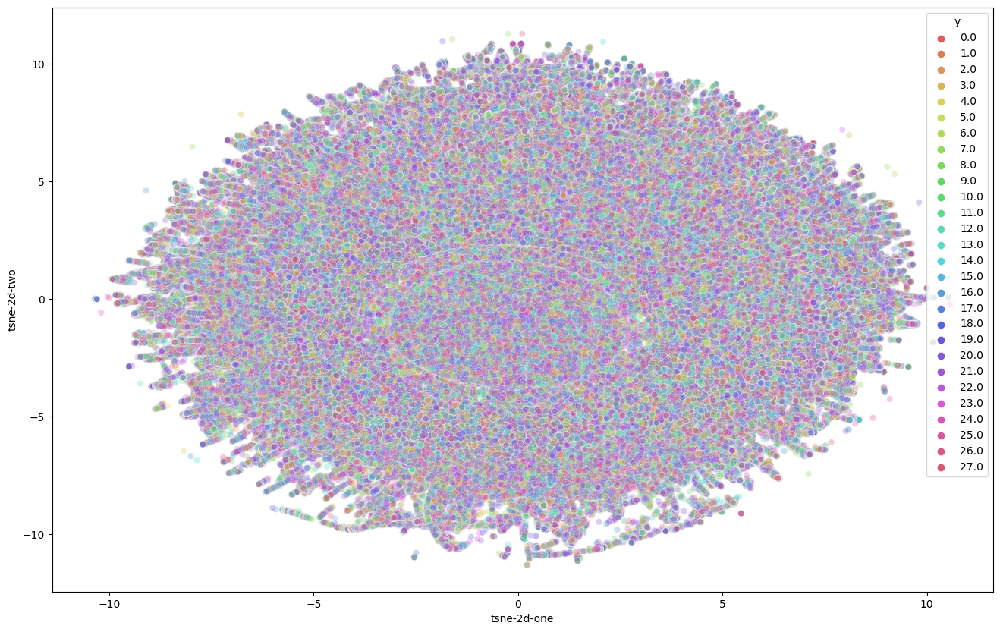

In [45]:
df_subset = pd.DataFrame()
df_subset['tsne-2d-one'] = text_t_sne[:,0]
df_subset['tsne-2d-two'] = text_t_sne[:,1]
df_subset['y'] = df['topic_le']

plt.figure(figsize=(16,10))
sns.scatterplot(
    x="tsne-2d-one", y="tsne-2d-two",
    hue="y",
    palette=sns.color_palette("hls", 28),
    #pallette = sns.color_palette("Paired"),
    data=df_subset,
    legend="full",
    alpha=0.3
)

Из графика можно заметить, что все тексты примерно одинаковые (с точки зрения tsne) и четкие кластеры не выделяются. 

Из этого можно сделать вывод, что задача кластеризации (обучение без учителя) скорее всего не даст хорошего качество.

Однако, такая каритнка может быть вызвана тем, что у нас слишком много точек (1 млн 100к), которые банально не умещаются в пространстве $R^2$. Также 27 кластеров тоже довольно много, особенно учитывая, что, во-первых, многие кластеры действительно похожи (например, "Россия" и "Бывший СССР") и, во-вторых, часть кластеров довольно малочислены (представлены менее 100 текстами). Поэтому попробуем посмотреть как tsne отработает на небольшом размере данных и с меньшим числом кластеров. 

___

### На части датасета

Сделаем коротенький датасет. А именно, оставим первые 7 самых популярных тем: `Россия, Мир, Экономика, Бывший СССР, Спорт, Наука и техника, Культура`.  
В принципе эти темы могут быть довольно различны ("Культура" и "Спорт" например). 

In [22]:
df['topic'].value_counts()

Россия               241055
Мир                  195778
Экономика            122120
Бывший СССР           93769
Спорт                 91267
Наука и техника       75609
Культура              71765
Интернет и СМИ        64800
Из жизни              44812
Силовые структуры     43287
Путешествия           22756
Ценности              22323
Дом                   22132
Среда обитания        15607
Бизнес                 7430
Моя страна             6128
Нацпроекты             4728
69-я параллель         3356
Забота о себе          3174
Крым                    666
Культпросвет            340
Легпром                 114
Библиотека               60
Оружие                   12
ЧМ-2014                   2
Мотор                     2
МедНовости                1
Сочи                      1
Name: topic, dtype: int64

In [27]:
names = list(df['topic'].value_counts().index[:7])

In [36]:
df_small = df[df['topic'].isin(names)]

In [37]:
df_small

,date,url,topic,tags,title,text_str,topic_le
0,1999-08-31,https://lenta.ru/news/1999/08/31/stancia_mir/,Россия,Все,"Космонавты сомневаются в надежности ""Мира""",становиться известно агентство ассошиэйтед пре...,20
1,1999-08-31,https://lenta.ru/news/1999/08/31/vzriv/,Россия,Все,Взрыв в центре Москвы: пострадало 30 человек,зал игровой автомат третий ярус подземный комп...,20
2,1999-08-31,https://lenta.ru/news/1999/08/31/credit_japs/,Россия,Все,Япония кредитует Россию на полтора миллиарда д...,япония принимать решение размораживать кредит ...,20
3,1999-08-31,https://lenta.ru/news/1999/08/31/diana/,Мир,Все,Британцы отмечают двухлетие смерти Дианы,британец отмечать сегодня скорбный дата вторую...,13
4,1999-08-31,https://lenta.ru/news/1999/08/31/mvf/,Россия,Все,Отмытые через Bank of NY деньги не имели отнош...,понедельник директор департамент внешний связь...,20
...,...,...,...,...,...,...,...
1155604,2022-11-18,https://lenta.ru/news/2022/11/18/bezhh/,Мир,Общество,Беженца из Украины избили после спора о нацистах,беженец украина избивать город кейзер американ...,13
1155605,2022-11-18,https://lenta.ru/news/2022/11/18/nurmagomedov/,Спорт,Бокс и ММА,Брат Нурмагомедова назвал цель выступления в B...,российский боец смешанный стиль мма двоюродный...,23
1155606,2022-11-18,https://lenta.ru/news/2022/11/18/bioprint/,Наука и техника,Будущее,Разработана технология печати ткани для трансп...,ученый израильский технологический институт ра...,16
1155607,2022-11-18,https://lenta.ru/news/2022/11/18/penni/,Мир,Политика,Республиканцы в Конгрессе потребовали проверит...,республиканец палата представитель конгресс сш...,13


In [40]:
y_small = df_small['topic_le']
df_small.drop('topic_le', axis=1, inplace=True)

C:\Users\sofi\AppData\Local\Temp\ipykernel_700\3567621886.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_small.drop('topic_le', axis=1, inplace=True)


Также, чтобы обучение не происходило слишком долго будем визуализировать только суммарно 90к объектов. Для понимания будут ли видны кластеры или нет этого вполне будет достаточно.

In [67]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_small, y_small, test_size=0.1, stratify=df_small['topic'])

In [87]:
Xtest['topic'].value_counts()

Россия             24106
Мир                19578
Экономика          12212
Бывший СССР         9377
Спорт               9127
Наука и техника     7561
Культура            7176
Name: topic, dtype: int64

In [69]:
Xtest

,date,url,topic,tags,title,text_str
3602,2000-01-26,https://lenta.ru/news/2000/01/26/snow/,Мир,Все,"На США, Австрию, Украину и Молдавию обрушились...",восточный побережье сша идти обильный снегопад...
991894,2021-10-28,https://lenta.ru/news/2021/10/28/trillioni/,Экономика,Госэкономика,Раскрыт размер госдолга российских регионов,раскрывать размер госдолг российский регион пе...
775166,2019-07-27,https://lenta.ru/news/2019/07/27/eposhka/,Наука и техника,Наука,Ученые объяснили жару в Европе и холод в России,аномальный жара европа сильный похолодание рос...
127245,2005-08-08,https://lenta.ru/news/2005/08/08/stay/,Мир,Все,Обвиняемых в лондонских терактах оставили под ...,суд заседание который состояться тюрьма белмар...
195070,2007-07-14,https://lenta.ru/news/2007/07/14/troops/,Мир,Все,Пакистанский смертник взорвал военную автоколонну,результат теракт пакистанский провинция северн...
...,...,...,...,...,...,...
759377,2019-05-07,https://lenta.ru/news/2019/05/07/bezpilotnik/,Мир,Политика,Американский беспилотник провел разведку около...,беспилотный аппарат военно-воздушный сила сша ...
268332,2009-02-10,https://lenta.ru/news/2009/02/10/jahnke/,Мир,Все,Ботинкометатель из Кембриджа не признал своей ...,аспирант кембридж бросать ботинок премьер-мини...
449846,2013-01-09,https://lenta.ru/news/2013/01/09/bill/,Россия,Все,Совет Федерации предложит регистрировать волон...,российский сенатор вносить рассмотрение госдум...
540404,2015-03-24,https://lenta.ru/news/2015/03/24/border/,Мир,Конфликты,Китай и Индия договорились поддерживать мир на...,китай индия договариваться поддерживать мир вд...


#### SVD разложение

В начале было попробовано применить **PCA**. Однако он не работает со spatce matrix, поэтому было решено перейти на SVD разложение.

In [70]:
lemmas = list(Xtest['text_str'])

tfidf = TfidfVectorizer(ngram_range=(1, 1))
bow = tfidf.fit_transform(lemmas)

bow

<89137x177481 sparse matrix of type '<class 'numpy.float64'>'
	with 8794402 stored elements in Compressed Sparse Row format>

In [71]:
svd = TruncatedSVD(n_components=2, random_state=42)
svd_result = svd.fit_transform(bow)

In [72]:
# pca = PCA(n_components=2)
# pca_result = pca.fit_transform(bow)

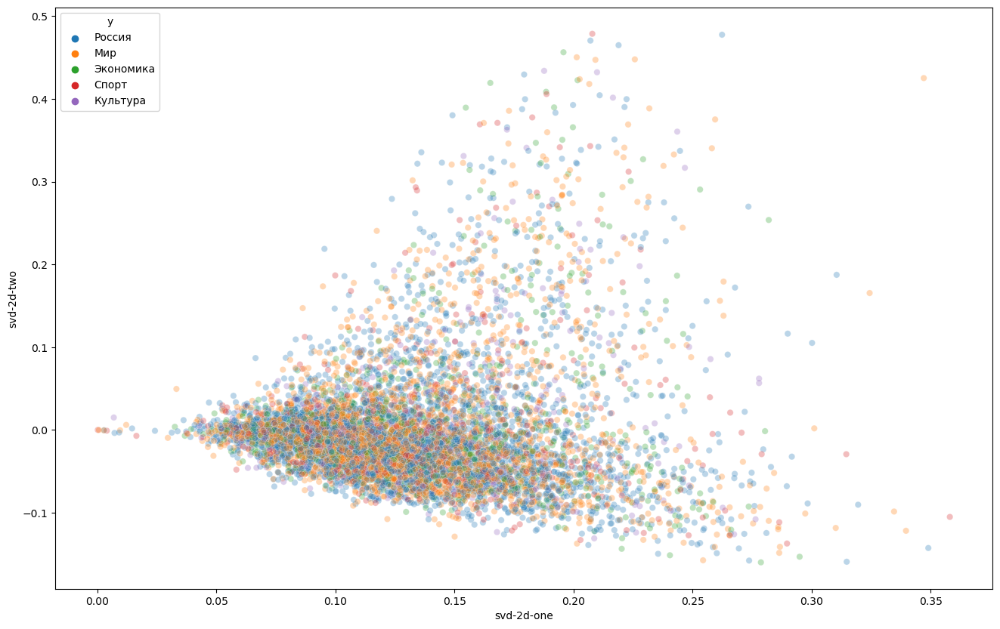

In [77]:
df_subset = pd.DataFrame()
df_subset['svd-2d-one'] = svd_result[:,0]
df_subset['svd-2d-two'] = svd_result[:,1]
df_subset['y'] = Xtest['topic']

plt.figure(figsize=(16,10))
sns.scatterplot(
    x="svd-2d-one", y="svd-2d-two",
    hue="y",
    #palette=sns.color_palette("hls", 7),
    data=df_subset,
    legend="full",
    alpha=0.3
);

Из графика видно, что кластеры визуально не заметны. Точки из всех категорий разбросаны по всему графику.

#### TSNE визализация

In [78]:
bow

<89137x177481 sparse matrix of type '<class 'numpy.float64'>'
	with 8794402 stored elements in Compressed Sparse Row format>

In [81]:
t_sne = manifold.TSNE(n_components=2, n_jobs=-1, random_state=132, perplexity=30)
text_t_sne = t_sne.fit_transform(bow)

C:\Users\sofi\AppData\Roaming\Python\Python39\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\sofi\AppData\Roaming\Python\Python39\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


In [88]:
len(text_t_sne)

89137

<AxesSubplot:xlabel='tsne-2d-one', ylabel='tsne-2d-two'>

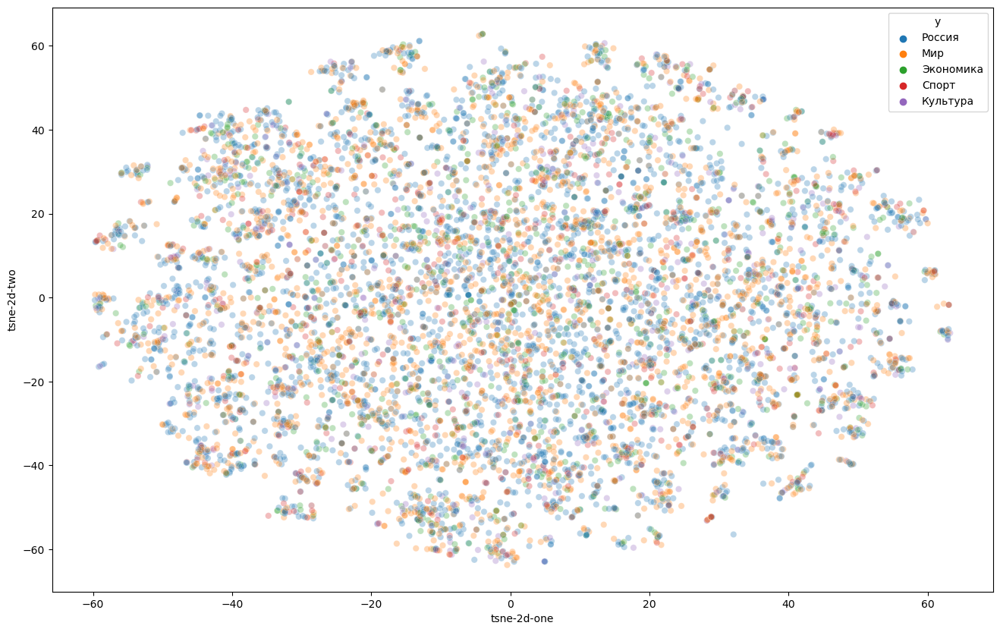

In [86]:
df_subset = pd.DataFrame()
df_subset['tsne-2d-one'] = text_t_sne[:,0]
df_subset['tsne-2d-two'] = text_t_sne[:,1]
df_subset['y'] = Xtest['topic']

plt.figure(figsize=(16,10))
sns.scatterplot(
    x="tsne-2d-one", y="tsne-2d-two",
    hue="y",
    #palette=sns.color_palette("hls", 7),
    #pallette = sns.color_palette("Paired"),
    data=df_subset,
    legend="full",
    alpha=0.3
)

Встречаем аналогичную картину. Точки из всех 5ти тем разбросаны по всей области, никакие кластеры не выделяются.

**Вывод**: скорее всего алгоритмы кластеризации, построенные на tf-idf, не дадут хорошего качества. 

# Облако слов

Также построем облако слов для всего датасета и для каждой категории таргета в отдельности.

In [2]:
def draw_wordcloud(data, photo: bool, name=None):
    wordcloud = WordCloud(
            width = 1280,
            height = 720,
            background_color='white',
            max_words=100,
            max_font_size=200,
            scale=3,
            random_state=123, 
            colormap='twilight')

    wc = wordcloud.generate(data)
    fig = plt.figure(1, figsize=(20, 12))
    plt.axis('off')
    plt.imshow(wordcloud)
    if photo == True:
        plt.savefig(name, bbox_inches='tight')
    plt.show()

In [3]:
def wordcloud_by_topic(topic):
    df_topic_f = df[df['topic'] == topic]
    df_topic_f.reset_index(inplace=True)
    data = ' '.join(df_topic_f.text_str[i] for i in tqdm(range(len(df_topic_f))))
    name1 = 'wordcloud_of_topic_{}'.format(topic)
    print('Облако слов для topic "{}"'.format(topic))
    draw_wordcloud(data, photo=True, name=name1)

#### Облако слов по всему датасету

In [7]:
text_string = ' '.join(df.text_str[i] for i in tqdm(range(len(df))))

100%|████████████████████████████████████████████████████████████████████| 1153094/1153094 [00:07<00:00, 147681.32it/s]


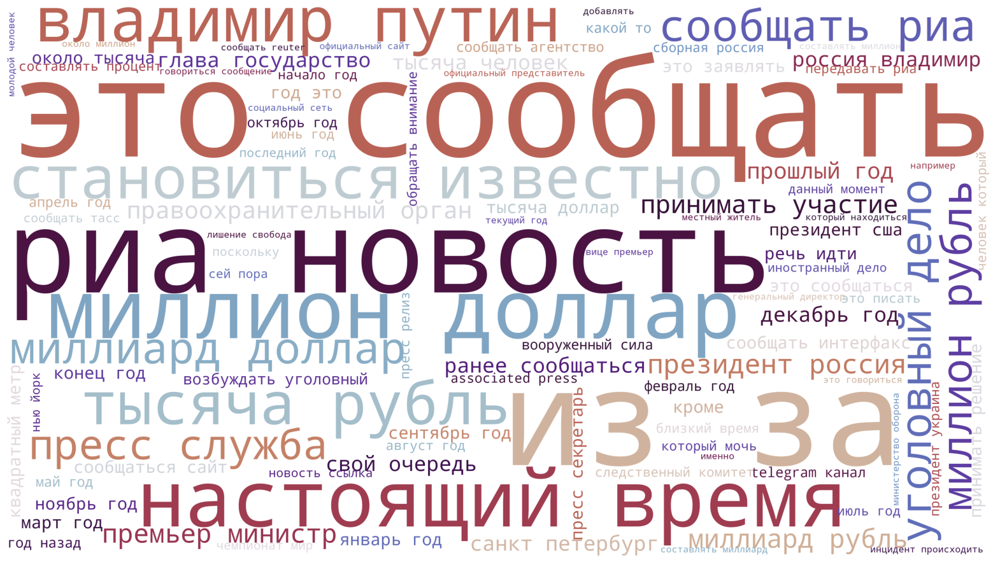

In [9]:
draw_wordcloud(text_string, photo=True, name='wordcloud_full_df')

#### Облако слов по topic

In [8]:
df['topic'].unique()

array(['Россия', 'Мир', 'Экономика', 'Интернет и СМИ', 'Спорт',
       'Культура', 'Из жизни', 'Силовые структуры', 'Наука и техника',
       'Бывший СССР', 'Дом', 'Сочи', 'ЧМ-2014', 'Путешествия',
       'Библиотека', 'Ценности', 'Легпром', 'Бизнес', 'МедНовости',
       'Оружие', '69-я параллель', 'Культпросвет ', 'Крым',
       'Среда обитания', 'Нацпроекты', 'Моя страна', 'Мотор',
       'Забота о себе'], dtype=object)

In [27]:
df['topic'].value_counts()

Россия               241055
Мир                  195778
Экономика            122120
Бывший СССР           93769
Спорт                 91267
Наука и техника       75609
Культура              71765
Интернет и СМИ        64800
Из жизни              44812
Силовые структуры     43287
Путешествия           22756
Ценности              22323
Дом                   22132
Среда обитания        15607
Бизнес                 7430
Моя страна             6128
Нацпроекты             4728
69-я параллель         3356
Забота о себе          3174
Крым                    666
Культпросвет            340
Легпром                 114
Библиотека               60
Оружие                   12
ЧМ-2014                   2
Мотор                     2
МедНовости                1
Сочи                      1
Name: topic, dtype: int64

In [26]:
list(df['topic'].value_counts().index)

['Россия',
 'Мир',
 'Экономика',
 'Бывший СССР',
 'Спорт',
 'Наука и техника',
 'Культура',
 'Интернет и СМИ',
 'Из жизни',
 'Силовые структуры',
 'Путешествия',
 'Ценности',
 'Дом',
 'Среда обитания',
 'Бизнес',
 'Моя страна',
 'Нацпроекты',
 '69-я параллель',
 'Забота о себе',
 'Крым',
 'Культпросвет ',
 'Легпром',
 'Библиотека',
 'Оружие',
 'ЧМ-2014',
 'Мотор',
 'МедНовости',
 'Сочи']

100%|██████████████████████████████████████████████████████████████████████| 241055/241055 [00:01<00:00, 144180.29it/s]


Облако слов для topic "Россия"


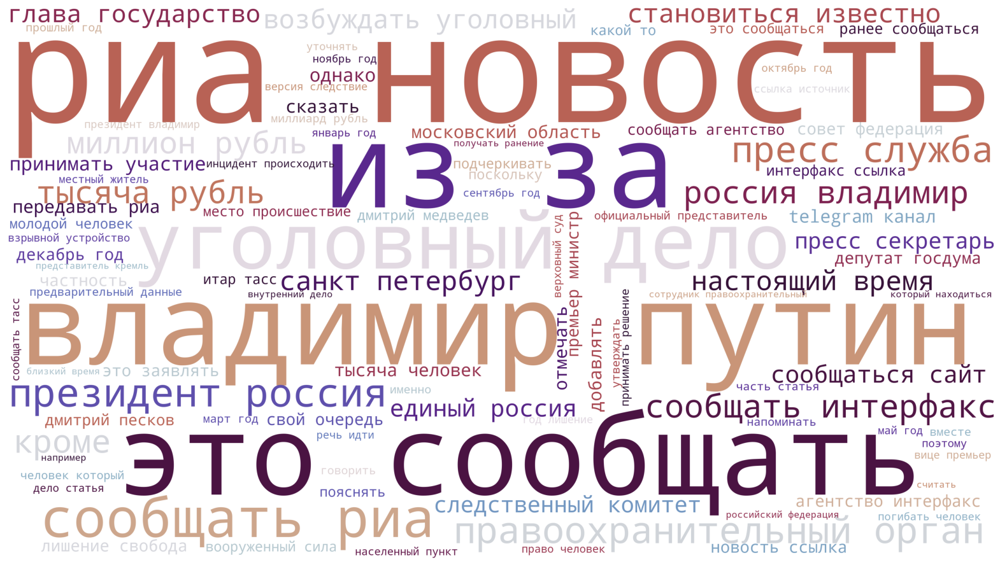

100%|██████████████████████████████████████████████████████████████████████| 195778/195778 [00:01<00:00, 144210.22it/s]


Облако слов для topic "Мир"


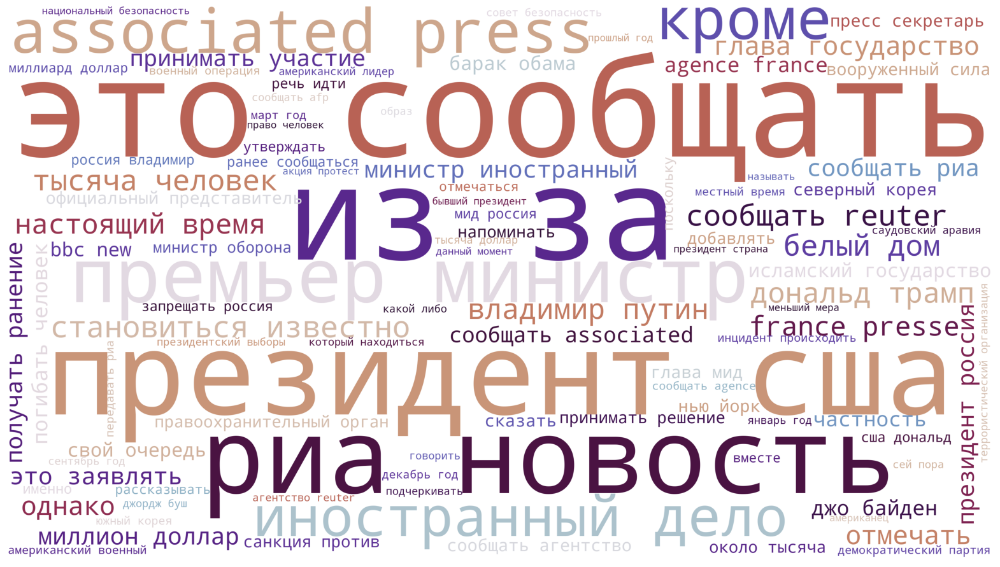

100%|██████████████████████████████████████████████████████████████████████| 122120/122120 [00:00<00:00, 139353.04it/s]


Облако слов для topic "Экономика"


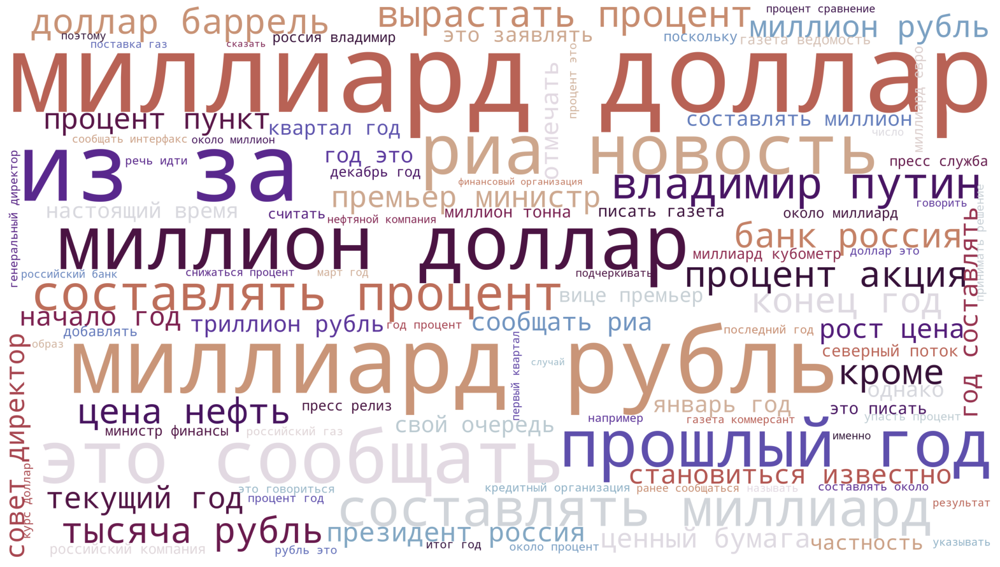

100%|████████████████████████████████████████████████████████████████████████| 93769/93769 [00:00<00:00, 138321.34it/s]


Облако слов для topic "Бывший СССР"


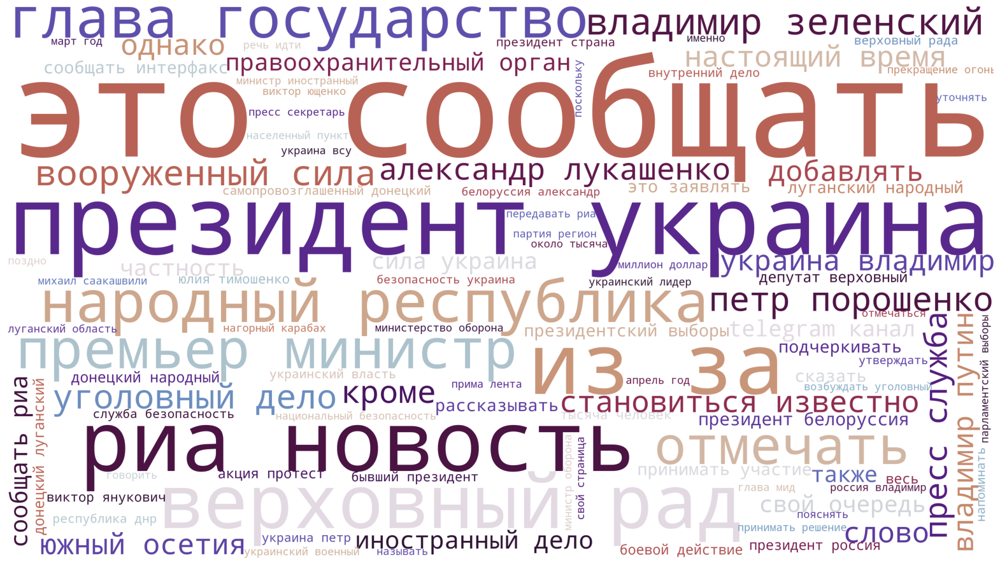

100%|████████████████████████████████████████████████████████████████████████| 91267/91267 [00:00<00:00, 144176.86it/s]


Облако слов для topic "Спорт"


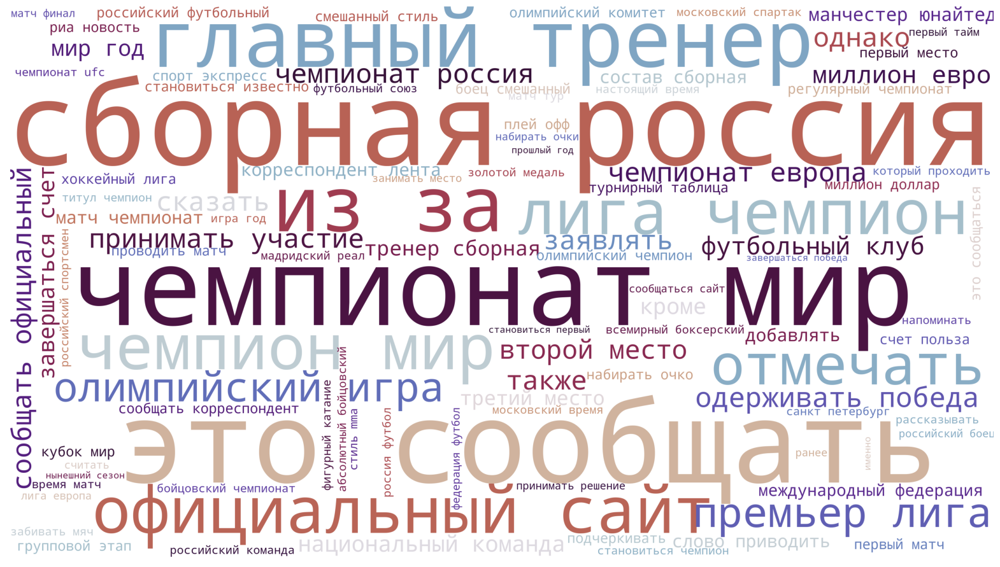

100%|████████████████████████████████████████████████████████████████████████| 75609/75609 [00:00<00:00, 146112.78it/s]


Облако слов для topic "Наука и техника"


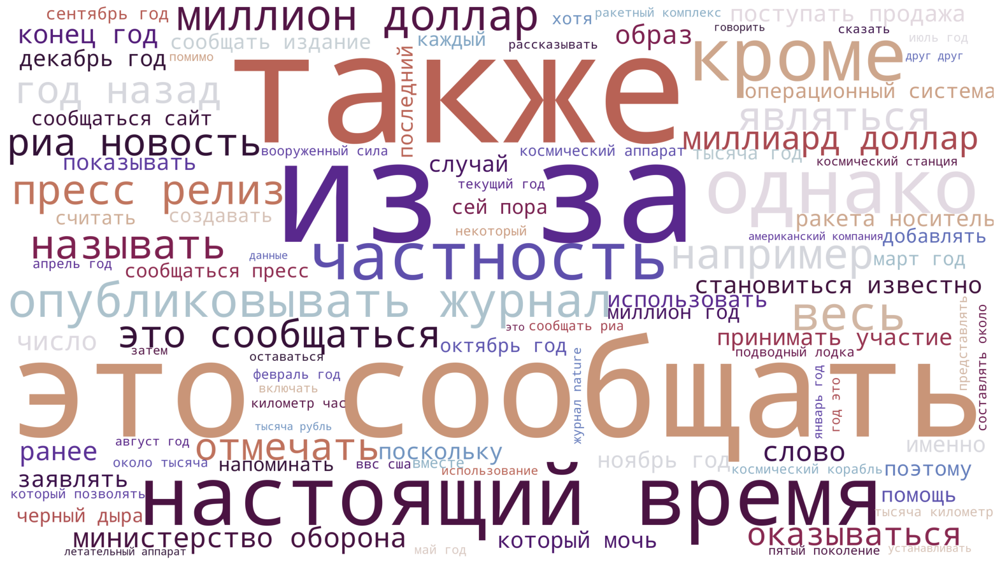

100%|████████████████████████████████████████████████████████████████████████| 71765/71765 [00:00<00:00, 145003.09it/s]


Облако слов для topic "Культура"


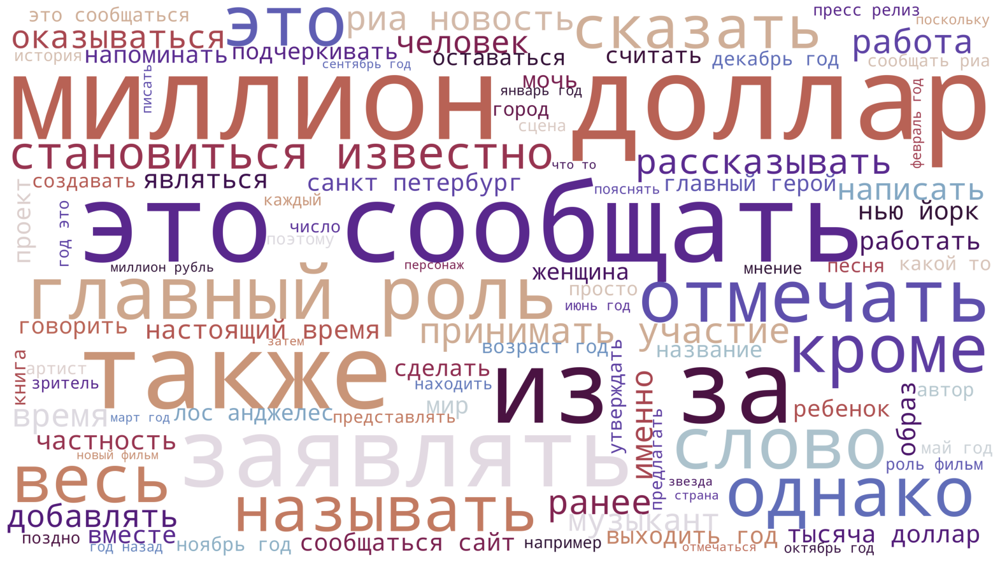

100%|████████████████████████████████████████████████████████████████████████| 64800/64800 [00:00<00:00, 144639.49it/s]


Облако слов для topic "Интернет и СМИ"


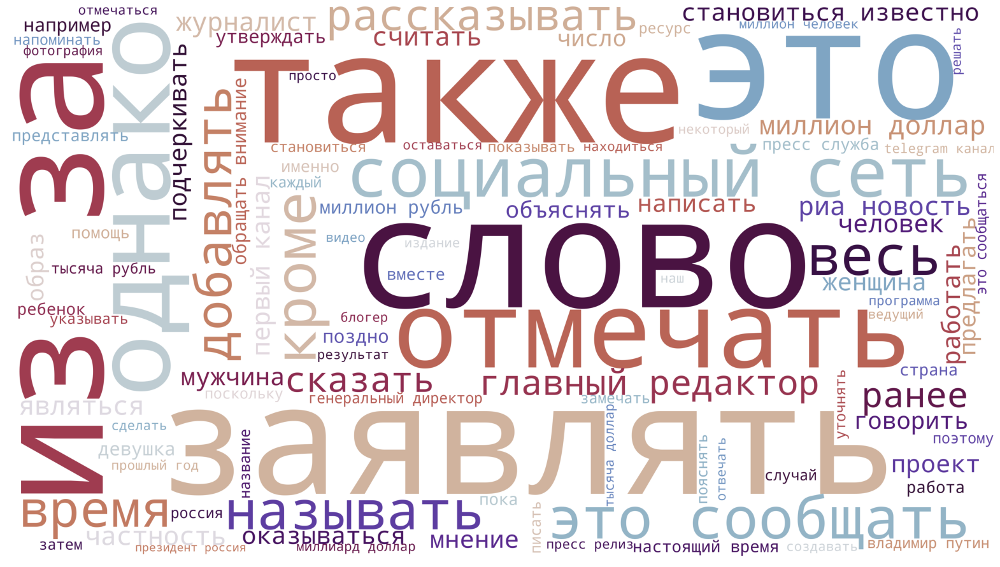

100%|████████████████████████████████████████████████████████████████████████| 44812/44812 [00:00<00:00, 141504.36it/s]


Облако слов для topic "Из жизни"


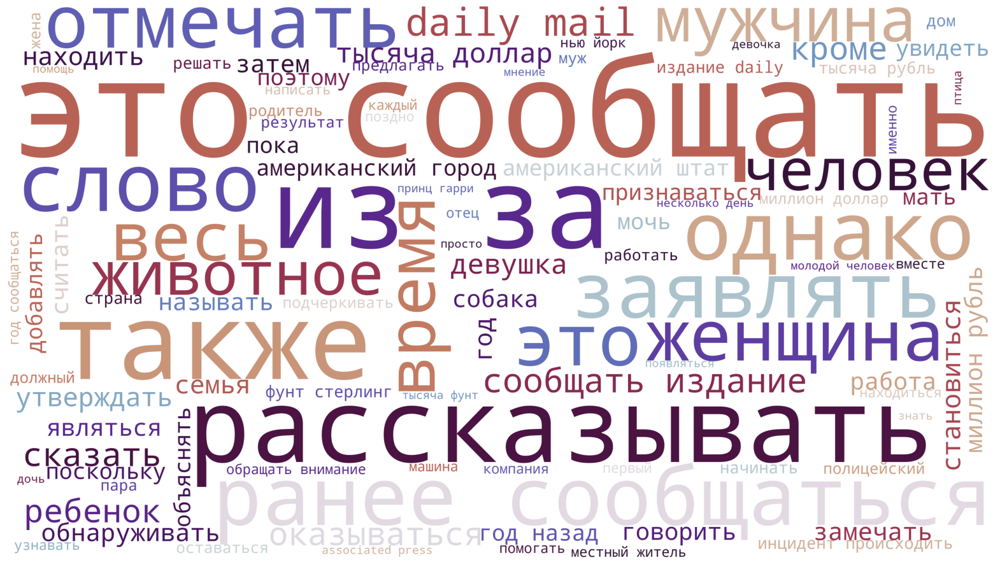

100%|████████████████████████████████████████████████████████████████████████| 43287/43287 [00:00<00:00, 151792.36it/s]


Облако слов для topic "Силовые структуры"


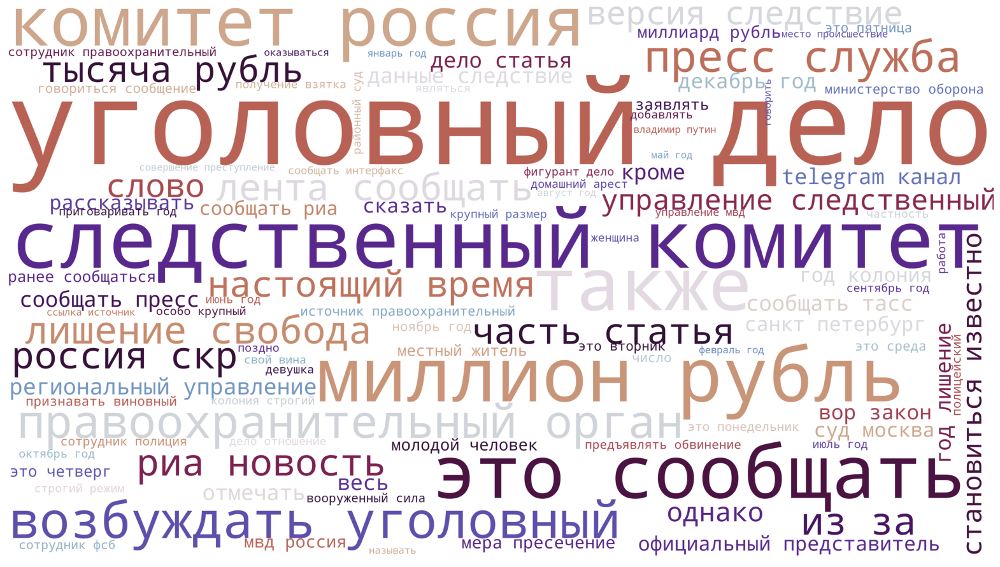

100%|████████████████████████████████████████████████████████████████████████| 22756/22756 [00:00<00:00, 139738.49it/s]


Облако слов для topic "Путешествия"


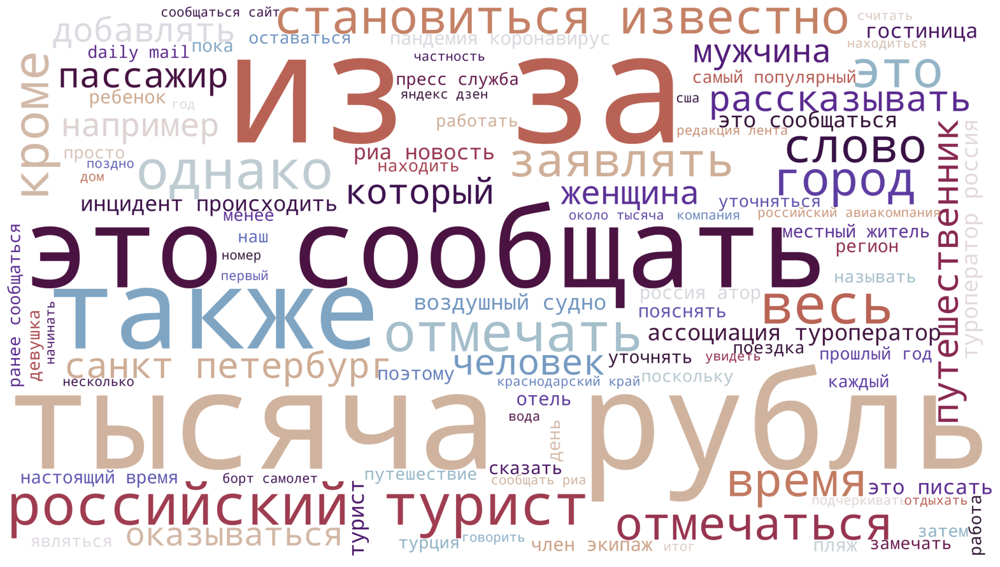

100%|████████████████████████████████████████████████████████████████████████| 22323/22323 [00:00<00:00, 145214.62it/s]


Облако слов для topic "Ценности"


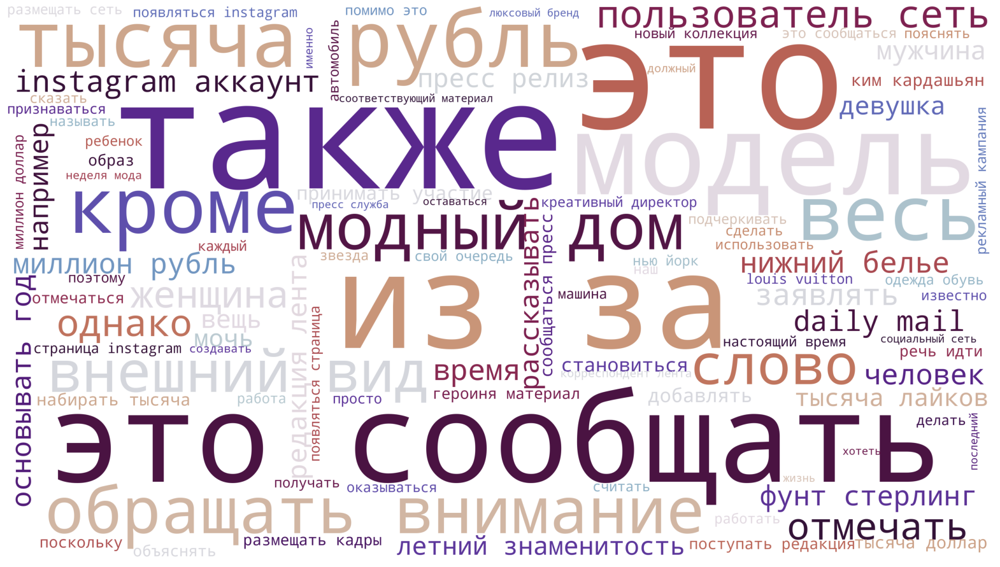

100%|████████████████████████████████████████████████████████████████████████| 22132/22132 [00:00<00:00, 135948.87it/s]


Облако слов для topic "Дом"


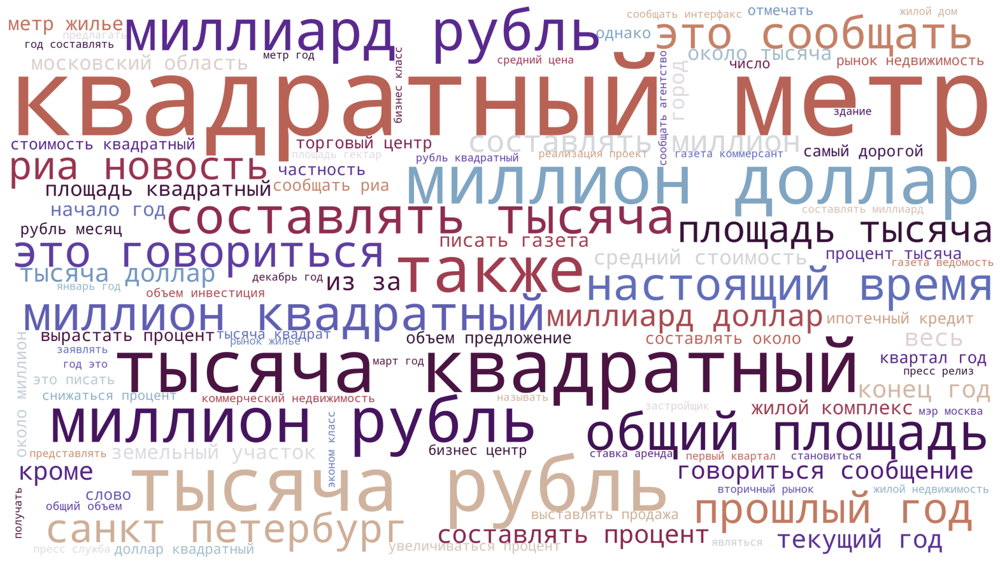

100%|████████████████████████████████████████████████████████████████████████| 15607/15607 [00:00<00:00, 134633.11it/s]


Облако слов для topic "Среда обитания"


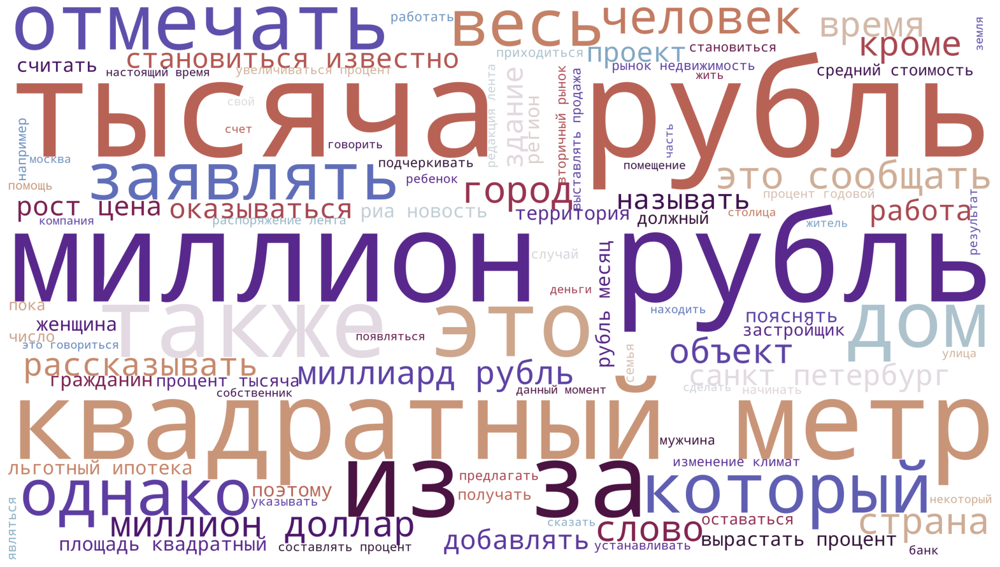

100%|██████████████████████████████████████████████████████████████████████████| 7430/7430 [00:00<00:00, 146062.86it/s]


Облако слов для topic "Бизнес"


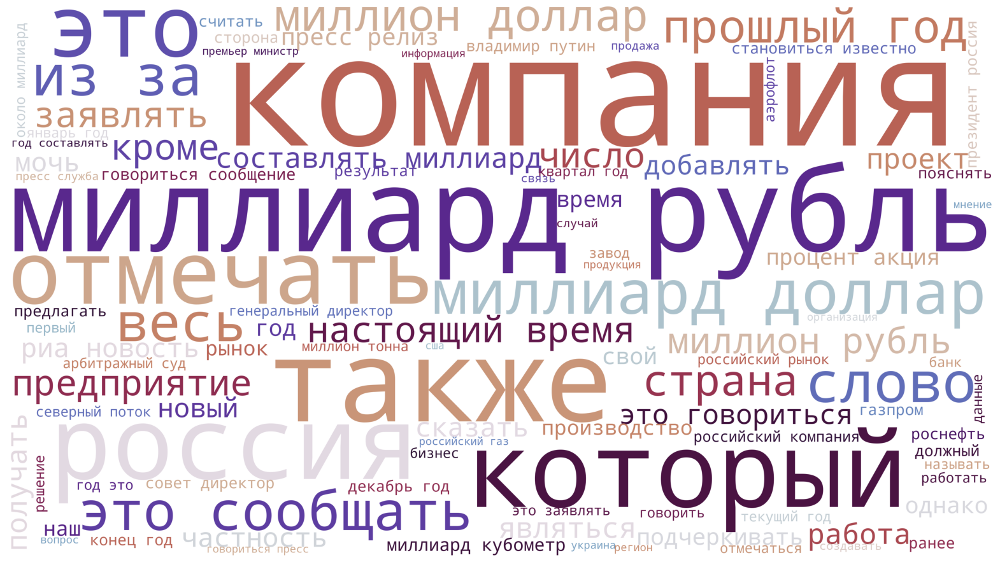

100%|██████████████████████████████████████████████████████████████████████████| 6128/6128 [00:00<00:00, 130885.78it/s]


Облако слов для topic "Моя страна"


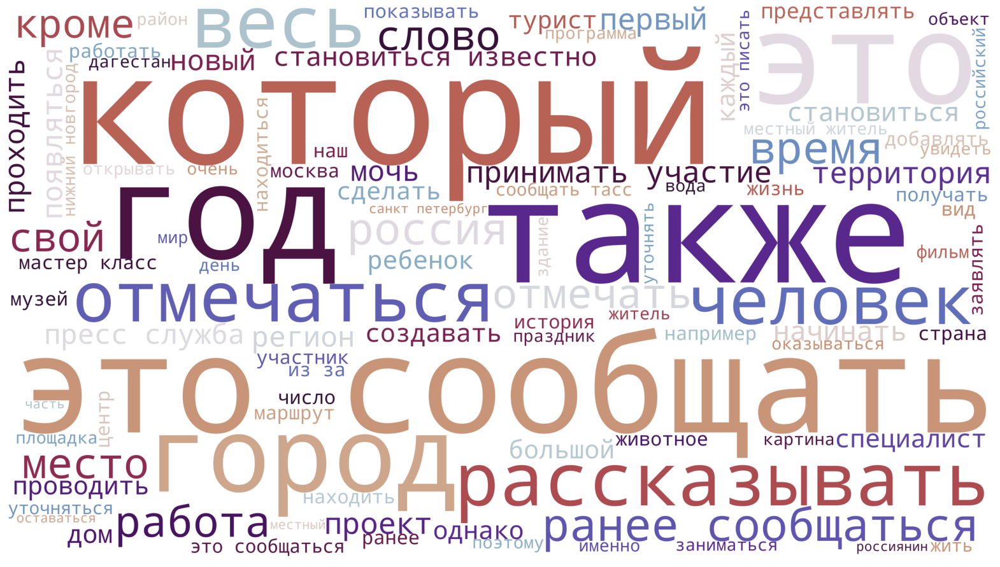

100%|██████████████████████████████████████████████████████████████████████████| 4728/4728 [00:00<00:00, 151739.39it/s]


Облако слов для topic "Нацпроекты"


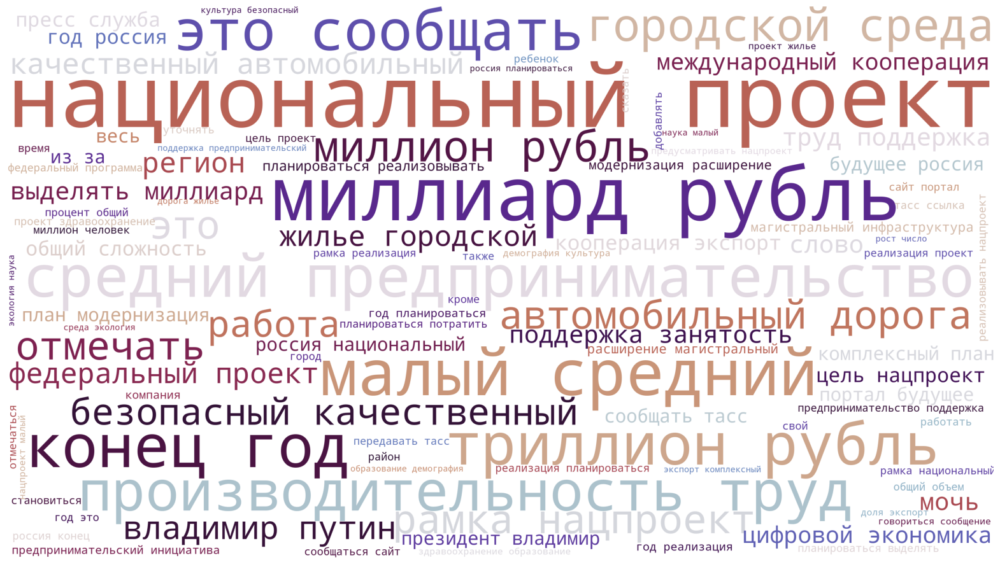

100%|██████████████████████████████████████████████████████████████████████████| 3356/3356 [00:00<00:00, 165134.73it/s]


Облако слов для topic "69-я параллель"


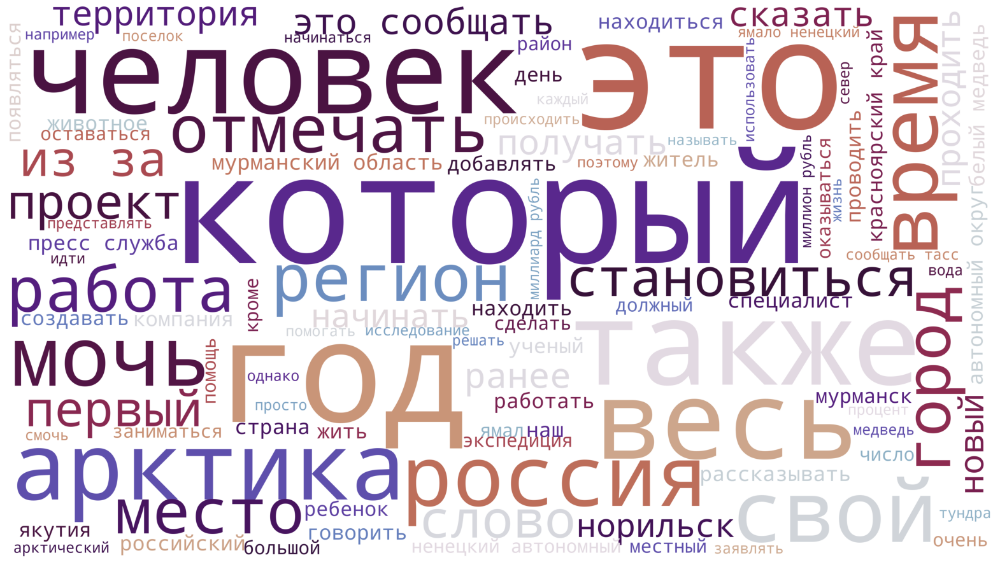

100%|██████████████████████████████████████████████████████████████████████████| 3174/3174 [00:00<00:00, 131780.41it/s]


Облако слов для topic "Забота о себе"


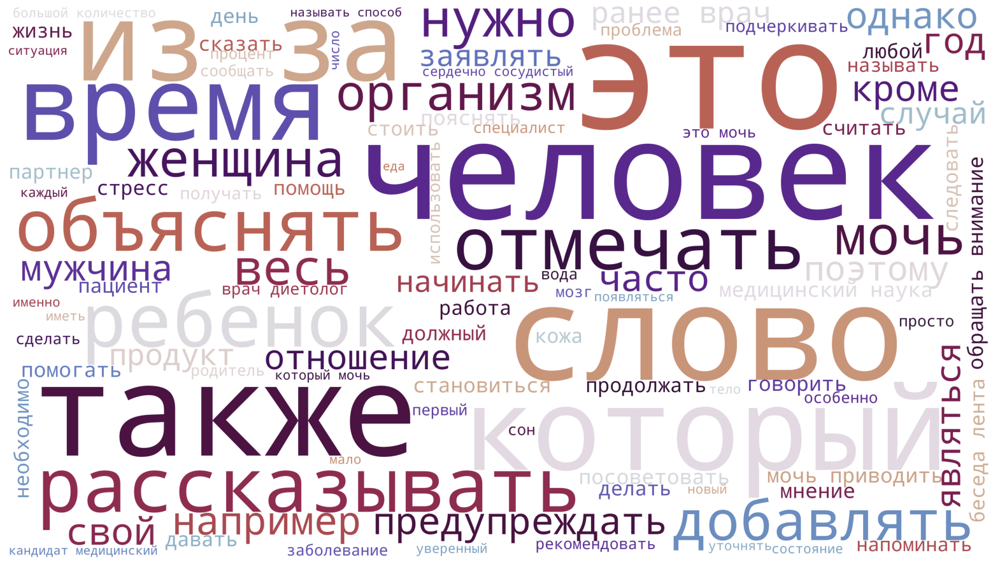

100%|████████████████████████████████████████████████████████████████████████████| 666/666 [00:00<00:00, 110559.90it/s]


Облако слов для topic "Крым"


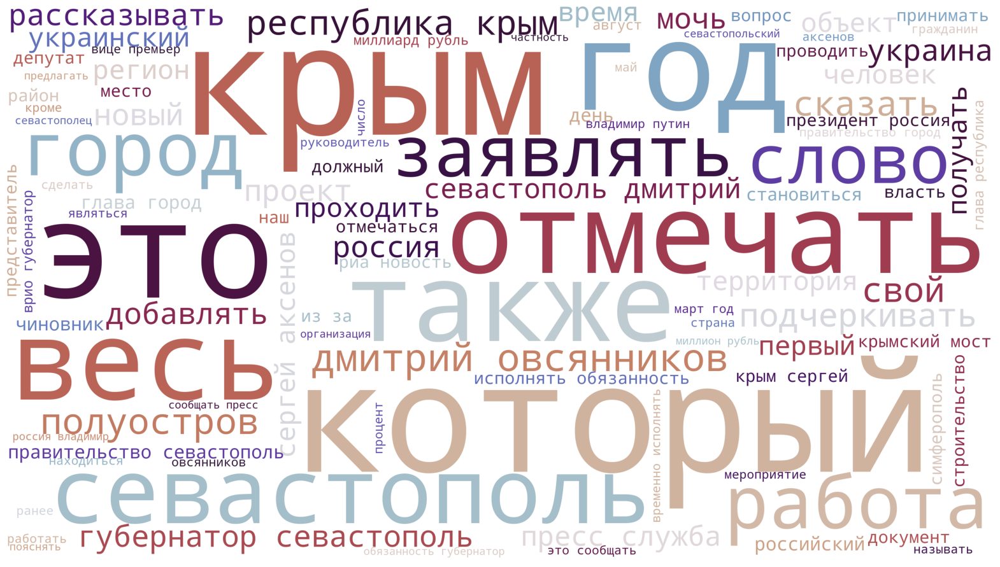

100%|████████████████████████████████████████████████████████████████████████████████████████| 340/340 [00:00<?, ?it/s]


Облако слов для topic "Культпросвет "


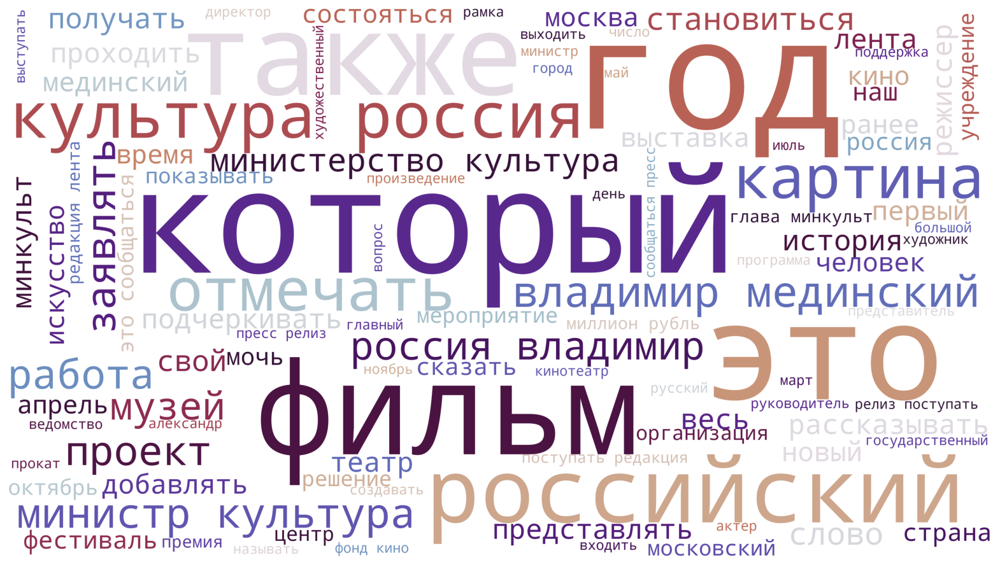

100%|████████████████████████████████████████████████████████████████████████████████████████| 114/114 [00:00<?, ?it/s]


Облако слов для topic "Легпром"


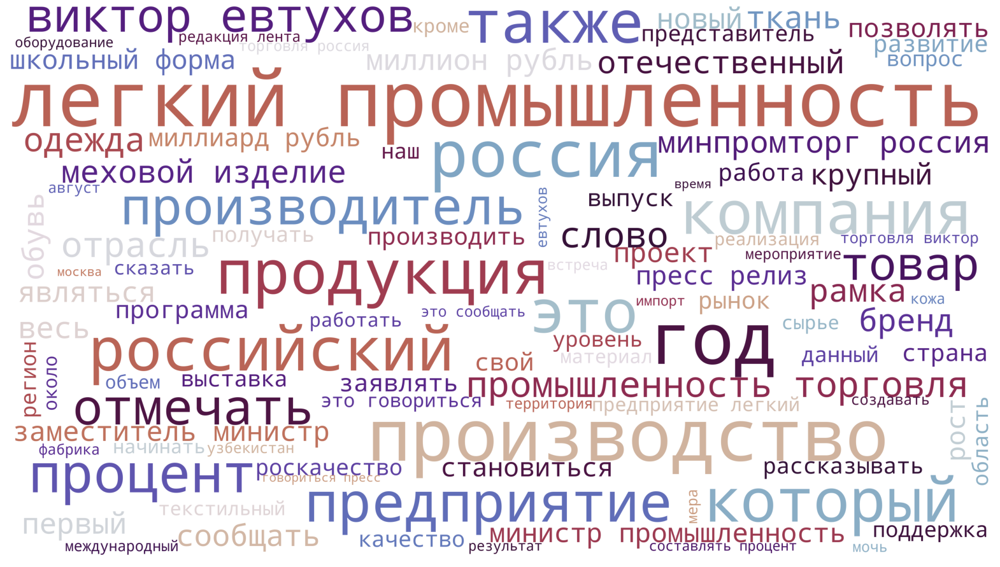

100%|██████████████████████████████████████████████████████████████████████████████████████████| 60/60 [00:00<?, ?it/s]


Облако слов для topic "Библиотека"


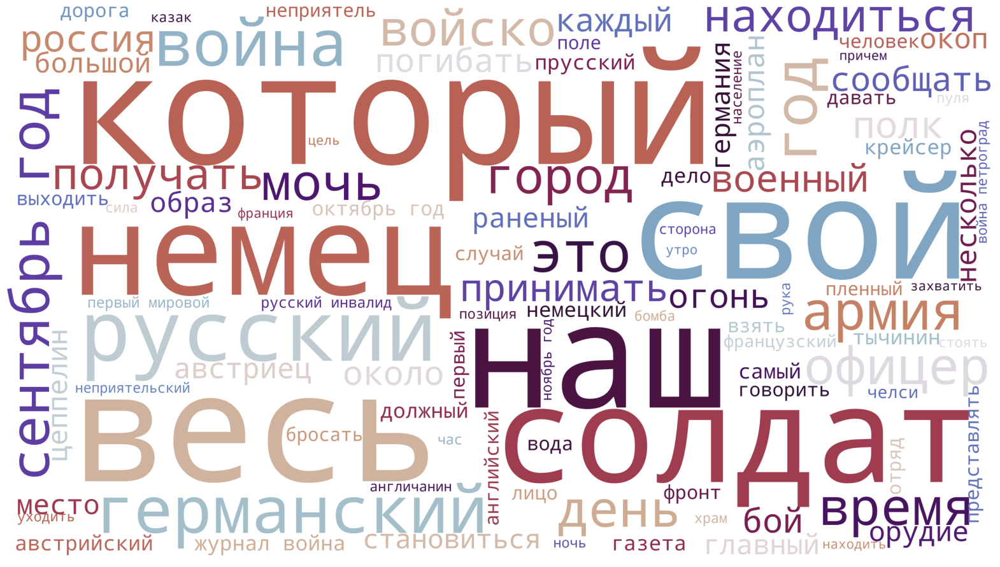

100%|██████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<?, ?it/s]


Облако слов для topic "Оружие"


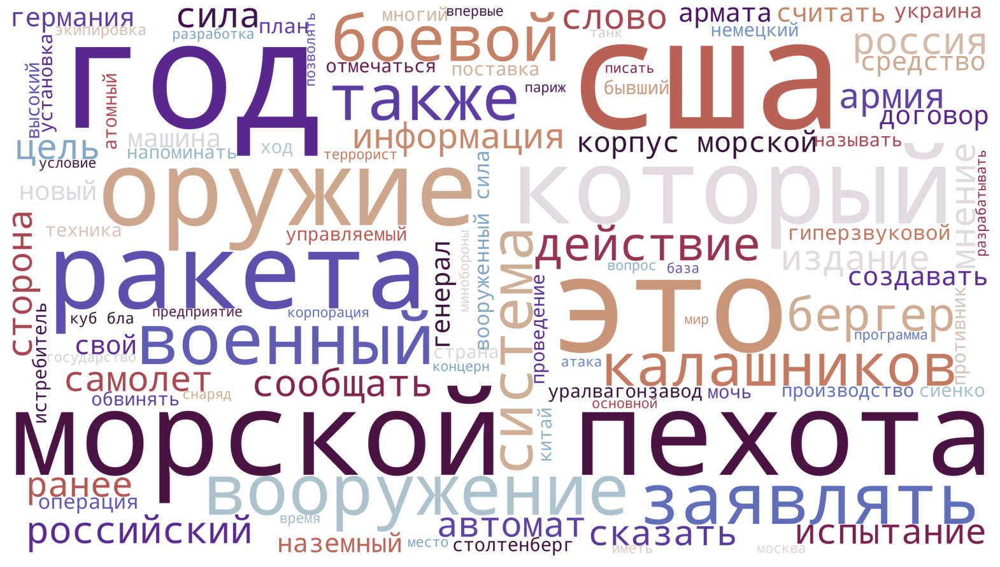

100%|████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<?, ?it/s]


Облако слов для topic "ЧМ-2014"


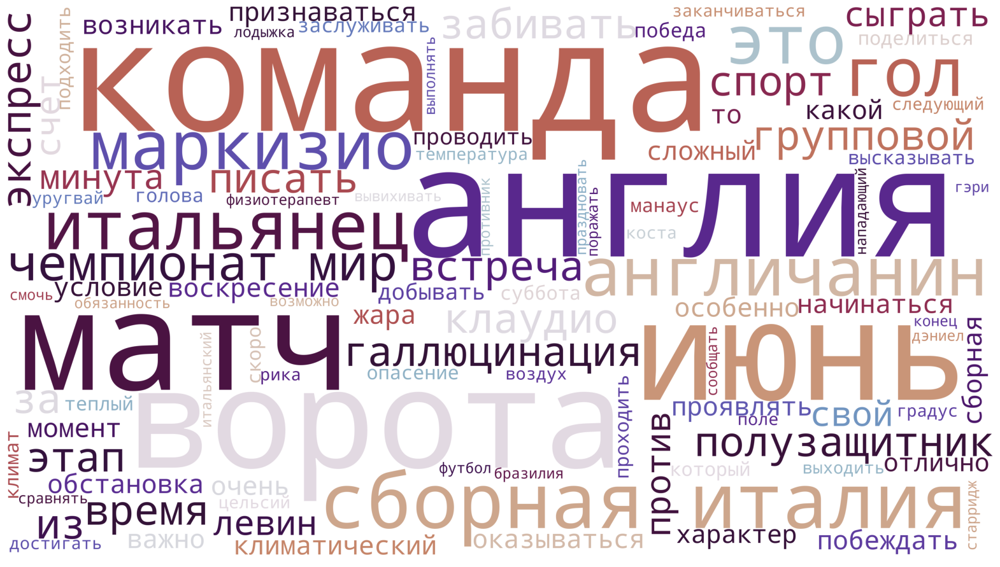

100%|████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<?, ?it/s]


Облако слов для topic "Мотор"


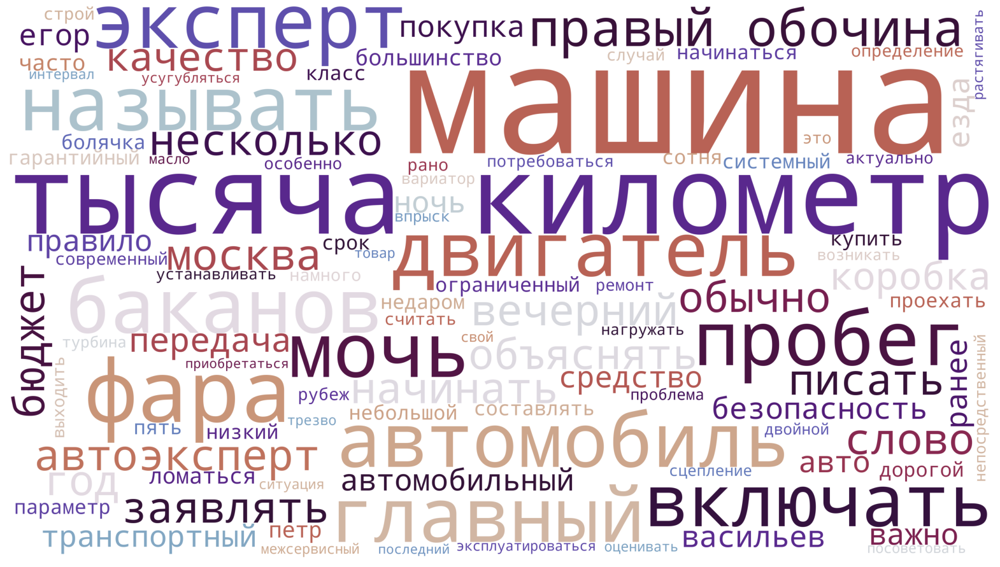

100%|████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<?, ?it/s]


Облако слов для topic "МедНовости"


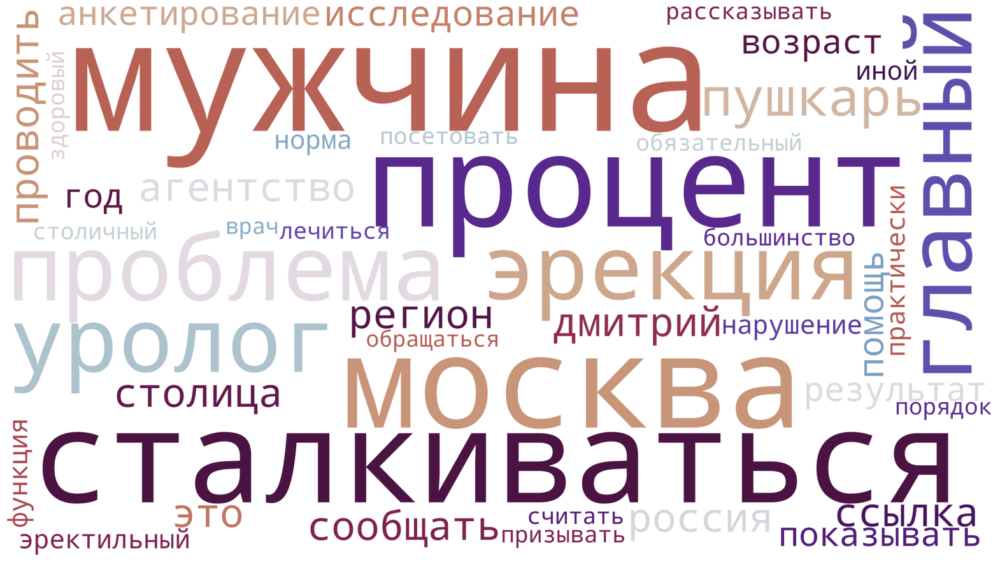

100%|████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<?, ?it/s]


Облако слов для topic "Сочи"


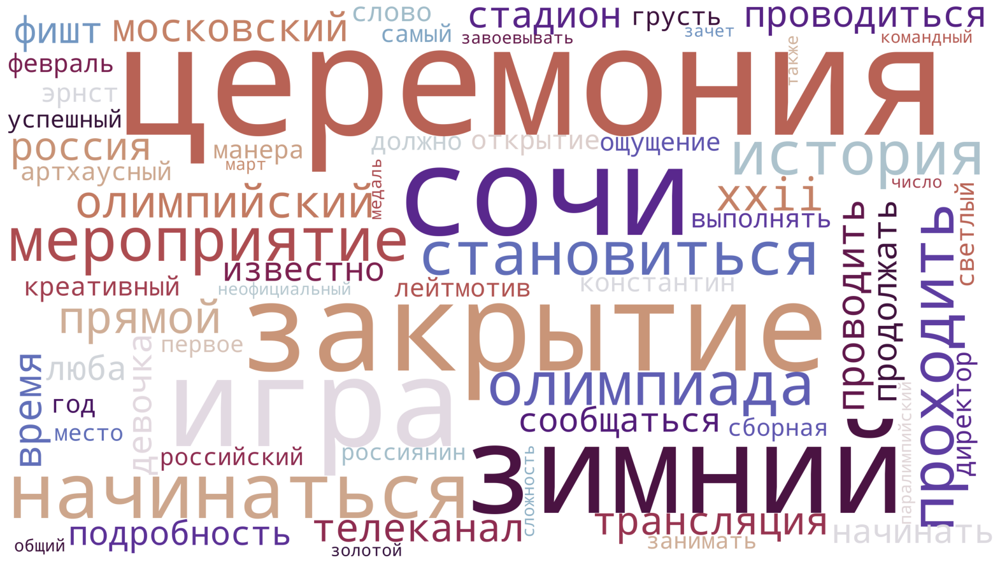

In [32]:
for tp in list(df['topic'].value_counts().index):
    wordcloud_by_topic(tp)

# Распределение новостей во времени по каждому топику

In [10]:
df.drop('Unnamed: 0', axis=1, inplace=True)
df.head()

,date,url,topic,tags,text_str,topic_le,title_lemmas,year,month,day,date_enc,season,day_of_week,dummy_weekday
0,1999-08-31,https://lenta.ru/news/1999/08/31/stancia_mir/,Россия,Все,становиться известно агентство ассошиэйтед пре...,20,космонавт сомневаться надежность мир,1999,8,31,0,3,1,1
1,1999-08-31,https://lenta.ru/news/1999/08/31/vzriv/,Россия,Все,зал игровой автомат третий ярус подземный комп...,20,взрыв центр москва пострадать человек,1999,8,31,0,3,1,1
2,1999-08-31,https://lenta.ru/news/1999/08/31/credit_japs/,Россия,Все,япония принимать решение размораживать кредит ...,20,япония кредитовать россия полтора миллиард доллар,1999,8,31,0,3,1,1
3,1999-08-31,https://lenta.ru/news/1999/08/31/diana/,Мир,Все,британец отмечать сегодня скорбный дата вторую...,13,британец отмечать двухлетие смерть диана,1999,8,31,0,3,1,1
4,1999-08-31,https://lenta.ru/news/1999/08/31/mvf/,Россия,Все,понедельник директор департамент внешний связь...,20,отмывать bank деньги иметь отношение мвф,1999,8,31,0,3,1,1


In [18]:
df['date'] = pd.to_datetime(df['date'])

In [152]:
print(f"Дни с {min(df['date'].dt.date)} по {max(df['date'].dt.date)}, всего {df['date'].nunique()} дней.")

Дни с 1999-08-31 по 2022-11-18, всего 8460 дней.


In [184]:
date_gr = df.groupby('topic')['date'].value_counts()
date_gr

topic           date      
69-я параллель  2022-07-21    13
                2021-11-15    10
                2022-02-25     9
                2016-03-15     7
                2021-12-22     7
                              ..
Экономика       2020-01-25     1
                2020-05-04     1
                2020-07-05     1
                2020-08-23     1
                2020-09-26     1
Name: date, Length: 84843, dtype: int64

In [185]:
date_gr = date_gr.reset_index(level='topic')
date_gr.rename(columns={'date': 'amount_of_news'}, inplace=True)
date_gr = date_gr.reset_index(level='date')
date_gr

,date,topic,amount_of_news
0,2022-07-21,69-я параллель,13
1,2021-11-15,69-я параллель,10
2,2022-02-25,69-я параллель,9
3,2016-03-15,69-я параллель,7
4,2021-12-22,69-я параллель,7
...,...,...,...
84838,2020-01-25,Экономика,1
84839,2020-05-04,Экономика,1
84840,2020-07-05,Экономика,1
84841,2020-08-23,Экономика,1


In [136]:
date_gr.topic.unique()

28

In [163]:
import warnings
warnings.filterwarnings("ignore")

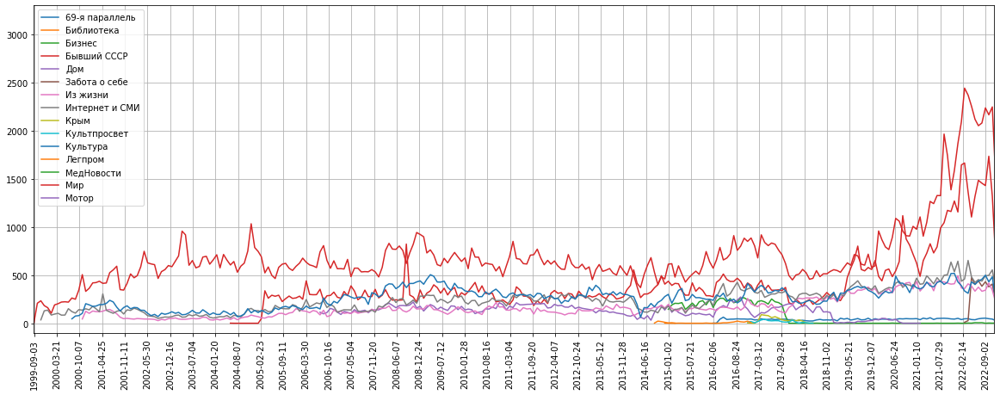

In [180]:
fig, ax = plt.subplots(figsize=(20,7)) 
for i in list(date_gr.topic.unique())[:15]:
    short_df = date_gr[date_gr['topic'] == i]
    short_df.drop('topic', axis=1, inplace=True)
    short_df = short_df.resample(rule='M', on='date').sum()
    short_df.sort_index(inplace=True)
    plt.plot(short_df.index, short_df['amount_of_news'], label=i) 

ax.grid()
ax.xaxis.set_major_locator(ticker.MultipleLocator(200))
plt.xticks(rotation=90)
plt.xlim(min(df['date'].dt.date), max(df['date'].dt.date))
plt.ylim(-100, 3300)
ax.legend()

plt.savefig('amount_of_topics_by_time_part1', bbox_inches='tight')

plt.show()

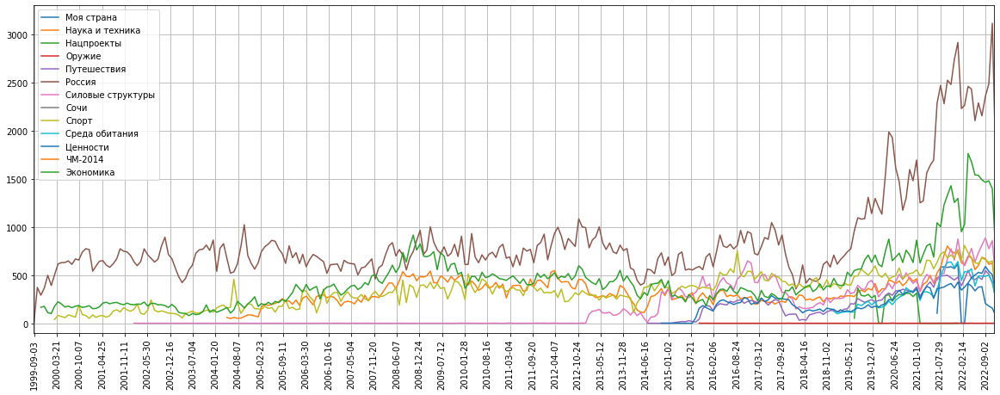

In [179]:
fig, ax = plt.subplots(figsize=(20,7)) 
for i in list(date_gr.topic.unique())[15:]:
    short_df = date_gr[date_gr['topic'] == i]
    short_df.drop('topic', axis=1, inplace=True)
    short_df = short_df.resample(rule='M', on='date').sum()
    short_df.sort_index(inplace=True)

    plt.plot(short_df.index, short_df['amount_of_news'], label=i) 

ax.grid()
ax.xaxis.set_major_locator(ticker.MultipleLocator(200))
plt.xticks(rotation=90)
plt.xlim(min(df['date'].dt.date), max(df['date'].dt.date))
plt.ylim(-100, 3300)
ax.legend()

plt.savefig('amount_of_topics_by_time_part2', bbox_inches='tight')

plt.show()

По графикам можно сделать два основных вывода:
1. Некоторые категории наблюдаются только на определенном временном промежутке (даже большинство так сказать).  
В каждом году представлены только классы `Россия, Мир, Экономика, Интернет и СМИ`.


2. Есть темы, которые представлены горазд бОльшим кол-вом объектов, чем другие